# Set Up

## Installs

In [ ]:
pip install numpy accelerate diffusers ftfy bitsandbytes safetensors wandb datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.4/122.4 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 13.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 10.4 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.10.0
    Uninstalling fsspec-2024.10.0:
      Successfully uninstalled fsspec-2024.10.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.


In [ ]:
%pip install -qq git+https://github.com/huggingface/diffusers

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
!wget -q https://raw.githubusercontent.com/huggingface/diffusers/main/examples/textual_inversion/textual_inversion.py

In [ ]:
!wget -q https://raw.githubusercontent.com/huggingface/diffusers/main/examples/textual_inversion/textual_inversion_sdxl.py

## Imports

In [ ]:
from diffusers import StableDiffusionPipeline, StableDiffusionXLPipeline, DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler
from diffusers.utils import make_image_grid
from string import whitespace
from google.colab import userdata, drive, files
from collections import OrderedDict
from safetensors.torch import load_file
from PIL import Image
from transformers import BlipProcessor, BlipForConditionalGeneration
from datasets import load_dataset

import torch
import os
import shutil
import tensorflow as tf
import datetime
import itertools
import matplotlib.pyplot as plt
import numpy as np
import datasets
import json
import requests
import wandb
import sys
import prep_utils

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
# del sys.modules['prep_utils']

## Environment config

In [ ]:
!accelerate config default

accelerate configuration saved at /root/.cache/huggingface/accelerate/default_config.yaml


In [ ]:
!wandb login

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


## Colab Secrets

In [ ]:
os.environ['HF_TOKEN']= userdata.get('Huggingface')

## Prep

In [ ]:
drive.mount('/content/drive') # access google drive

Mounted at /content/drive


### Setup Single Training Run

In [ ]:
base_dir = '/content/drive/MyDrive/training_images' # path to all training images in google drive
train_directory = '/content/train_images' # path to move the training images to
results_dir = '/content/drive/My Drive/results' # path to result models/embeddings
subfolders = ['textinv', 'dbooth', 'dlora', 'lora'] # subfolders for creating the folder structure

# adjust the parameters below depending on the training process
training_method = 'textinv' # training method in this notebook
training_model = 'SDXL' # model version in this notebook
training_subject = 'leander' # subject reference to train on

prep_utils.create_folder_structure(results_dir, subfolders)

prep_utils.setup_training_environment(train_directory, results_dir, training_model, training_method, training_subject)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Root directory already exists: /content/drive/My Drive/results
Subfolder already exists: /content/drive/My Drive/results/textinv
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/flux
Subfolder already exists: /content/drive/My Drive/results/dbooth
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/flux
Subfolder already exists: /content/drive/My Drive/results/dlora
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDv1.5
Sub-subfolder 

In [ ]:
images = prep_utils.load_images(base_dir, training_subject)


In [ ]:
prep_utils.move_images(training_subject, images, train_directory)

Saved /content/train_images/leander_1.jpg
Saved /content/train_images/leander_2.jpg
Saved /content/train_images/leander_3.jpg
Saved /content/train_images/leander_4.jpg
Saved /content/train_images/leander_5.jpg
Saved /content/train_images/leander_6.jpg
Saved /content/train_images/leander_7.jpg
Saved /content/train_images/leander_8.jpg
Saved /content/train_images/leander_9.jpg
Saved /content/train_images/leander_10.jpg


In [ ]:
shutil.rmtree("/content/test")

In [ ]:
shutil.copytree("/content/drive/MyDrive/training_images/leander/leander_15", "/content/test")

'/content/test'

### Setup Training Loop

In [ ]:
base_dir = '/content/drive/MyDrive/training_images' # path to all training images in google drive
train_directory = '/content/train_images' # path to move the training images to
results_dir = '/content/drive/My Drive/results' # path to result models/embeddings
subfolders = ['textinv', 'dbooth', 'dlora', 'lora'] # subfolders for creating the folder structure
# subject_list = ['hannah','timh', 'celine', 'marco', 'jannik', 'christoph', 'patrick','timk', 'leander', 'nils'] # only needed for complete training loop,
subject_list = ['timk', 'leander', 'nils']
# subject_list = ['hannah', 'timh', 'celine', 'timk', 'leander'] #
# subject_list = ['hannah','leander','nils'] # only needed for complete training loop,
# subject_list = ['christoph', 'marco', 'nils']
# subject_list =['jannik']

# adjust the parameters below depending on the training process
training_method = 'textinv' # training method in this notebook
training_model = 'SDv1.5' # model version in this notebook

prep_utils.create_folder_structure(results_dir, subfolders)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Root directory already exists: /content/drive/My Drive/results
Subfolder already exists: /content/drive/My Drive/results/textinv
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/textinv/flux
Subfolder already exists: /content/drive/My Drive/results/dbooth
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/SDv1.5
Sub-subfolder already exists: /content/drive/My Drive/results/dbooth/flux
Subfolder already exists: /content/drive/My Drive/results/dlora
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDXL
Sub-subfolder already exists: /content/drive/My Drive/results/dlora/SDv1.5
Sub-subfolder 

In [ ]:
prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject


Removed /content/train_images/leander_5.jpg
Removed /content/train_images/leander_3.jpg
Removed /content/train_images/leander_8.jpg
Removed /content/train_images/leander_1.jpg
Removed /content/train_images/leander_2.jpg
Removed /content/train_images/leander_6.jpg
Removed /content/train_images/leander_4.jpg
Removed /content/train_images/leander_7.jpg
Removed /content/train_images/leander_10.jpg
Removed /content/train_images/leander_9.jpg
Directory /content/train_images has been emptied.


# Upload Training Images

In [ ]:
prep_utils.alt_upload_images(train_directory)

Uploading instance images for `photo of a sks man`


Saving 20160725_122032-min.jpg to 20160725_122032-min.jpg
Saving 20160729_163510-min.jpg to 20160729_163510-min.jpg
Saving 20160811_102314_HDR-min.jpg to 20160811_102314_HDR-min.jpg
Saving 20160811_142619-min.jpg to 20160811_142619-min.jpg
Saving 20160811_142739_HDR-min.jpg to 20160811_142739_HDR-min.jpg
Saving 20160813_095807-min.jpg to 20160813_095807-min.jpg
Saving 20170609_200041_2-min.jpg to 20170609_200041_2-min.jpg
Saving 20170609_200041-min.jpg to 20170609_200041-min.jpg
Saving 20170812_133843_HDR-min.jpg to 20170812_133843_HDR-min.jpg
Saving 20170825_182747_HDR-min.jpg to 20170825_182747_HDR-min.jpg
Saving IMAG0083-min.jpg to IMAG0083-min.jpg
Saving IMAG0167-min.jpg to IMAG0167-min.jpg
Saving SDC10451-min.JPG to SDC10451-min.JPG
Saving SDC11260-min.JPG to SDC11260-min.JPG
Saving WhatsApp Image 2024-08-26 at 22.27.46 (1)-min.jpeg to WhatsApp Image 2024-08-26 at 22.27.46 (1)-min.jpeg
Saving WhatsApp Image 2024-08-26 at 22.27.49-min.jpeg to WhatsApp Image 2024-08-26 at 22.27.49-m

# Trainings

## Training textual inversion embed (SD 1.5)

In [ ]:
!echo $TRAIN_DIR
!echo $OUTPUT_DIR
!echo $MODEL_NAME
!echo $VALID_PROMPT
!echo $RESOLUTION
!echo $PLACEHOLDER_TOKEN
!echo $INITIALIZER_TOKEN

/content/train_images
/content/drive/My Drive/results/textinv/SDXL/leander
stabilityai/stable-diffusion-xl-base-1.0
business headshot of a <sks> man
1024
<sks>
man


In [ ]:
!mkdir "/content/drive/MyDrive/results/archive/sdxl_leander_16"

In [ ]:
# Check if the MODEL_NAME is set correctly
if os.environ.get('MODEL_NAME') == 'benjamin-paine/stable-diffusion-v1-5':
    # Define the parameters for the training script
    train_params = {
        "pretrained_model_name_or_path": os.environ.get('MODEL_NAME'),
        "train_data_dir": os.environ.get('TRAIN_DIR'),
        "learnable_property": "object",
        "placeholder_token": os.environ.get('PLACEHOLDER_TOKEN'),
        "initializer_token": os.environ.get('INITIALIZER_TOKEN'),
        "resolution": os.environ.get('RESOLUTION'),
        "train_batch_size": 4,
        "num_vectors": 16,
        "gradient_accumulation_steps": 1,
        "max_train_steps": 10000,
        "learning_rate": 5e-05,
        # "scale_lr": True,
        "lr_scheduler": "constant",
        "lr_warmup_steps": 0,
        "validation_prompt": os.environ.get('VALID_PROMPT'),
        "validation_steps":100,
        "output_dir": os.environ.get('OUTPUT_DIR'),
        "mixed_precision": "fp16",
        "checkpointing_steps": 100,
        "report_to": "wandb",
        "seed": 42,
    }

    # Save the parameters to a text file
    params_file = os.path.join(os.environ.get('OUTPUT_DIR'), "training_params.txt")
    with open(params_file, "w") as f:
        for key, value in train_params.items():
            f.write(f"{key}: {value}\n")

    # Construct the command to run the training script
    !accelerate launch textual_inversion.py \
        --pretrained_model_name_or_path="{train_params['pretrained_model_name_or_path']}"  \
        --output_dir="{train_params['output_dir']}" \
        --train_data_dir="{train_params['train_data_dir']}" \
        --resolution={train_params['resolution']} \
        --learnable_property="{train_params['learnable_property']}" \
        --initializer_token="{train_params['initializer_token']}" \
        --placeholder_token="{train_params['placeholder_token']}" \
        --train_batch_size="{train_params['train_batch_size']}" \
        --gradient_accumulation_steps={train_params['gradient_accumulation_steps']} \
        --num_vectors={train_params['num_vectors']} \
        --resume_from_checkpoint="latest" \
        --max_train_steps={train_params['max_train_steps']} \
        --checkpointing_steps={train_params['checkpointing_steps']} \
        --mixed_precision="{train_params['mixed_precision']}" \
        --learning_rate={train_params['learning_rate']} --lr_scheduler="{train_params['lr_scheduler']}" --lr_warmup_steps={train_params['lr_warmup_steps']} \
        --validation_steps={train_params['validation_steps']} --validation_prompt="{train_params['validation_prompt']}" --report_to="{train_params['report_to']}" \
        --seed={train_params['seed']}
else:
    print("Cannot run training script. Environment variable MODEL_NAME is not set correctly. Set MODEL_NAME correctly or use appropriate training script.")

Cannot run training script. Environment variable MODEL_NAME is not set correctly. Set MODEL_NAME correctly or use appropriate training script.


In [ ]:
# !accelerate launch textual_inversion.py \
#   --pretrained_model_name_or_path="benjamin-paine/stable-diffusion-v1-5" \
#   --train_data_dir="/content/data/pat" \
#   --learnable_property="person" \
#   --placeholder_token="<sks>" \
#   --initializer_token="man" \
#   --resolution=512 \
#   --train_batch_size=2 \
#   --gradient_accumulation_steps=4 \
#   --max_train_steps=200 \
#   --learning_rate=5e-03 \
#   --scale_lr \
#   --lr_scheduler="constant" \
#   --lr_warmup_steps=0 \
#   --validation_prompt="A <sks> man" \
#   --num_validation_images=4 \
#   --validation_steps=100 \
#   --output_dir=$OUTPUT_DIR


2024-09-02 15:35:45.993112: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-02 15:35:46.013214: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-02 15:35:46.019197: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-02 15:35:47.194910: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
09/02/2024 15:35:48 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

tokenizer/tokenizer_config.json: 100% 806/806 [00:00<00:00, 5.62MB/s]
tokeni

## Training Loop (SD 1.5)

In [ ]:
!mkdir '/content/drive/My Drive/results/archive/ti_test'

In [ ]:
for subject in subject_list:
  prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject

  training_subject = subject

  prep_utils.setup_training_environment(train_directory, results_dir, training_model, training_method, training_subject)
  images = prep_utils.load_images(base_dir, training_subject)
  prep_utils.move_images(training_subject, images, train_directory)

  # Check if the MODEL_NAME is set correctly
  if os.environ.get('MODEL_NAME') == 'benjamin-paine/stable-diffusion-v1-5':
      # Define the parameters for the training script
      train_params = {
          "pretrained_model_name_or_path": os.environ.get('MODEL_NAME'),
          "train_data_dir": os.environ.get('TRAIN_DIR'),
          "learnable_property": "object",
          "placeholder_token": os.environ.get('PLACEHOLDER_TOKEN'),
          "initializer_token": os.environ.get('INITIALIZER_TOKEN'),
          "resolution": os.environ.get('RESOLUTION'),
          "train_batch_size": 4,
          "num_vectors": 8,
          "gradient_accumulation_steps": 1,
          "max_train_steps": 2000,
          "learning_rate": 1e-04,
          # "scale_lr": True,
          "lr_scheduler": "constant",
          "lr_warmup_steps": 0,
          "validation_prompt": os.environ.get('VALID_PROMPT'),
          "validation_steps":100,
          "output_dir": os.environ.get('OUTPUT_DIR'),
          "mixed_precision": "fp16",
          "checkpointing_steps": 100,
          "report_to": "wandb",
          "seed": 42,
      }

      # Save the parameters to a text file
      params_file = os.path.join(os.environ.get('OUTPUT_DIR'), "training_params.txt")
      with open(params_file, "w") as f:
          for key, value in train_params.items():
              f.write(f"{key}: {value}\n")

      # Construct the command to run the training script
      !accelerate launch textual_inversion.py \
          --pretrained_model_name_or_path="{train_params['pretrained_model_name_or_path']}"  \
          --output_dir="{train_params['output_dir']}" \
          --train_data_dir="{train_params['train_data_dir']}" \
          --resolution={train_params['resolution']} \
          --learnable_property="{train_params['learnable_property']}" \
          --initializer_token="{train_params['initializer_token']}" \
          --placeholder_token="{train_params['placeholder_token']}" \
          --train_batch_size="{train_params['train_batch_size']}" \
          --gradient_accumulation_steps={train_params['gradient_accumulation_steps']} \
          --num_vectors={train_params['num_vectors']} \
          --resume_from_checkpoint="latest" \
          --max_train_steps={train_params['max_train_steps']} \
          --checkpointing_steps={train_params['checkpointing_steps']} \
          --mixed_precision="{train_params['mixed_precision']}" \
          --learning_rate={train_params['learning_rate']} --lr_scheduler="{train_params['lr_scheduler']}" --lr_warmup_steps={train_params['lr_warmup_steps']} \
          --validation_steps={train_params['validation_steps']} --validation_prompt="{train_params['validation_prompt']}" --report_to="{train_params['report_to']}" \
          --seed={train_params['seed']}
  else:
      print("Cannot run training script. Environment variable MODEL_NAME is not set correctly. Set MODEL_NAME correctly or use appropriate training script.")

  prep_utils.empty_directory(train_directory) # removes images and captions from train_directory to prepare for training the next subject


Directory does not exist: /content/train_images
Saved /content/train_images/timk_1.jpg
Saved /content/train_images/timk_2.jpg
Saved /content/train_images/timk_3.jpg
Saved /content/train_images/timk_4.jpg
Saved /content/train_images/timk_5.jpg
Saved /content/train_images/timk_6.jpg
Saved /content/train_images/timk_7.jpg
Saved /content/train_images/timk_8.jpg
Saved /content/train_images/timk_9.jpg
Saved /content/train_images/timk_10.jpg
2024-11-06 11:01:47.545880: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-06 11:01:47.567149: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-06 11:01:47.573493: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting t

## Training Text Inversion Embed (SDXL)

In [ ]:
!pip3 install -U xformers --index-url https://download.pytorch.org/whl/cu121


Looking in indexes: https://download.pytorch.org/whl/cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.7/16.7 MB 103.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.4/780.4 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 88.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 51.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 113.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 18.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import xformers

In [ ]:
!mkdir "/content/drive/MyDrive/results/archive/sdxl_leander_27"

In [ ]:
# Check if the MODEL_NAME is set correctly
if os.environ.get('MODEL_NAME') == 'stabilityai/stable-diffusion-xl-base-1.0':
    # Define the parameters for the training script
    train_params = {
        "pretrained_model_name_or_path": os.environ.get('MODEL_NAME'),
        "train_data_dir": "/content/test",
        "learnable_property": "object",
        "placeholder_token": os.environ.get('PLACEHOLDER_TOKEN'),
        "initializer_token": os.environ.get('INITIALIZER_TOKEN'),
        "resolution": 512,
        "train_batch_size": 4,
        "num_vectors": 4,
        "gradient_accumulation_steps": 1,
        # "use_8bit_adam": True,
        # "gradient_checkpointing":True,
        "max_train_steps": 5000,
        "learning_rate": 3e-03,
        # "xformers_memory_efficient_attention": True,
        # "scale_lr": True,
        "lr_scheduler": "cosine",
        "lr_warmup_steps": 0,
        "validation_prompt": os.environ.get('VALID_PROMPT'),
        "validation_steps":100,
        "output_dir": "/content/drive/MyDrive/results/archive/sdxl_leander_27",
        "mixed_precision": "bf16",
        "checkpointing_steps": 500,
        "report_to": "wandb",
        "seed": 42,
    }

    # Save the parameters to a text file
    # params_file = os.path.join(os.environ.get('OUTPUT_DIR'), "training_params.txt")
    # with open(params_file, "w") as f:
    #     for key, value in train_params.items():
    #         f.write(f"{key}: {value}\n")

    # Construct the command to run the training script
    !accelerate launch textual_inversion_sdxl.py \
        --pretrained_model_name_or_path="{train_params['pretrained_model_name_or_path']}"  \
        --output_dir="{train_params['output_dir']}" \
        --train_data_dir="{train_params['train_data_dir']}" \
        --resolution={train_params['resolution']} \
        --learnable_property="{train_params['learnable_property']}" \
        --initializer_token="{train_params['initializer_token']}" \
        --placeholder_token="{train_params['placeholder_token']}" \
        --train_batch_size="{train_params['train_batch_size']}" \
        --gradient_accumulation_steps={train_params['gradient_accumulation_steps']} \
        --num_vectors={train_params['num_vectors']} \
        --resume_from_checkpoint="latest" \
        --max_train_steps={train_params['max_train_steps']} \
        --checkpointing_steps={train_params['checkpointing_steps']} \
        --mixed_precision="{train_params['mixed_precision']}" \
        --learning_rate={train_params['learning_rate']} --lr_scheduler="{train_params['lr_scheduler']}" --lr_warmup_steps={train_params['lr_warmup_steps']} \
        --validation_steps={train_params['validation_steps']} --validation_prompt="{train_params['validation_prompt']}" --report_to="{train_params['report_to']}" \
        --seed={train_params['seed']}
else:
    print("Cannot run training script. Environment variable MODEL_NAME is not set correctly. Set MODEL_NAME correctly or use appropriate training script.")


  #  --gradient_checkpointing \
  #          --use_8bit_adam \
          # --enable_xformers_memory_efficient_attention \


2024-10-31 22:16:04.485693: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-31 22:16:04.506770: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-31 22:16:04.513214: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-31 22:16:05.836010: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
10/31/2024 22:16:07 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: bf16

{'clip_sample_range', 'rescale_betas_zero_snr', 'thresholding', 'variance_

In [ ]:
# !accelerate launch textual_inversion_sdxl.py \
#   --pretrained_model_name_or_path="stabilityai/stable-diffusion-xl-base-1.0" \
#   --train_data_dir="/content/data/pat" \
#   --learnable_property="object" \
#   --placeholder_token="<sks>" \
#   --initializer_token="man" \
#   --mixed_precision="bf16" \
#   --resolution=768 \
#   --gradient_accumulation_steps=4 \
#   --max_train_steps=1000 \
#   --train_batch_size=1 \
#   --learning_rate=5e-03 \
#   --scale_lr \
#   --lr_scheduler="constant" \
#   --lr_warmup_steps=0 \
#   --save_steps=100 \
#   --validation_prompt="<sks> man" \
#   --validation_steps=20 \
#   --output_dir=$OUTPUT_DIR

2024-09-05 12:17:37.777777: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-05 12:17:37.797208: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-05 12:17:37.803112: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-05 12:17:38.964251: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
09/05/2024 12:17:40 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: bf16

{'clip_sample_range', 'rescale_betas_zero_snr', 'thresholding', 'variance_

# Inference

## Inference (SD 1.5)

In [ ]:
from diffusers import DiffusionPipeline, UNet2DConditionModel
from transformers import CLIPTextModel
import torch
# model_path ="dreambooth/patrick"
from diffusers import AutoencoderKL

In [ ]:
pipeline = StableDiffusionPipeline.from_pretrained(
    "benjamin-paine/stable-diffusion-v1-5", torch_dtype=torch.float16, use_safetensors=True, safety_checker=None,
).to("cuda")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
pipeline.unload_textual_inversion(tokens="<sks>")

ValueError: No tokens to remove found

In [ ]:
# fix args to make it work here
# pipeline.load_textual_inversion("textinv/dil_test2/checkpoint-500", weight_name="model.safetensors",token="<sks>")
# pipeline.load_textual_inversion("/content/drive/My Drive/results/archive/sd15_textinv_hannah_1/checkpoint-3700", weight_name="model.safetensors", safety_checker=None, token="<sks>")
# pipeline.load_textual_inversion("textinv/pat", safety_checker=None, token="<sks>")
pipeline.load_textual_inversion("/content/drive/My Drive/results/archive/sd15_textinv_jannik_4/learned_embeds-steps-2000.safetensors", safety_checker=None, token="<sks>")


In [ ]:
# pipeline.enable_attention_slicing()
schedulers = [DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler]
pipeline.scheduler = schedulers[2].from_config(pipeline.scheduler.config)

if pipeline.scheduler == DPMSolverMultistepScheduler:
  pipeline.scheduler.use_karras_sigmas = True

In [ ]:
prompt = "business headshot of a <sks> man, business clothing"
# prompt = "business headshot of a handsome <sks> man"
# neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"
# num_samples_per_row = 2
# num_rows = 2

In [ ]:
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    # neg_prompts = batch_size * [neg_prompt]
    num_inference_steps = 30
    guidance_scale=7

    return {"prompt": prompts, "generator":generator, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}

In [ ]:
# prompt += "frontal shot, serious look, business clothing, handsome, beautiful face, model, photorealistic, masterpiece, ultra high res, ultra detailed, extremely detailed face"
# prompt += "50mm portrait photography, 8k, high definition, plain white background"

In [ ]:
from diffusers.utils import make_image_grid
images = pipeline(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)


In [ ]:

for i, image in enumerate(images):
    image.save(f"image_{i}.png")

## Inference Grid (SD 1.5)


In [ ]:
total_pipes = 2
pipes = []
schedulers = [DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler]

In [ ]:
for i in range(total_pipes):
  pipe = StableDiffusionPipeline.from_pretrained(
    "benjamin-paine/stable-diffusion-v1-5", torch_dtype=torch.float16, use_safetensors=True, safety_checker=None,
  ).to("cuda")
  pipe.load_textual_inversion("/content/drive/MyDrive/textinv/pat", safety_checker=None, token="<sks>")
  pipe.enable_attention_slicing()
  pipe.scheduler = schedulers[i].from_config(pipe.scheduler.config)
  pipes.append(pipe)

Keyword arguments {'safety_checker': None} are not expected by StableDiffusionXLPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Keyword arguments {'safety_checker': None} are not expected by StableDiffusionXLPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [ ]:
prompt = "business headshot of a handsome <sks> man, professional clothing, serious face, open eyes"
neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

In [ ]:
inf_start= 30
scale_start=4
max_inf_steps=80
max_scale=9
inf_step_increase=10
scale_increase=1

In [ ]:
grid_rows=int(max_scale-scale_start)
grid_cols=int((max_inf_steps-inf_start)/inf_step_increase)

In [ ]:
print(grid_rows)
print(grid_cols)

5
5


In [ ]:
def create_parameter_list(prompt, neg_prompt):
    """Creates a list of dictionaries containing the parameters.

    Args:
        prompt: The prompt for the model.
        neg_prompt: The negative prompt for the model.

    Returns:
        A list of dictionaries containing the parameters.
    """

    parameters = []
    for num_inference_steps in range(inf_start, max_inf_steps, inf_step_increase):
        for guidance_scale in range(scale_start, max_scale, scale_increase):
            parameters.append({
                "prompt": prompt,
                "neg_prompt": neg_prompt,
                "num_inference_steps": num_inference_steps,
                "guidance_scale": guidance_scale
            })
    return parameters

parameter_list = create_parameter_list(prompt, neg_prompt)

In [ ]:
def create_image_grid(images, columns, rows, figsize=(10,10),labels_x=None, labels_y=None):
    """
    Creates a grid of images using matplotlib and numpy.

    Args:
        images: A list of image data.
        columns: The number of columns in the grid.
        rows: The number of rows in the grid.
        labels_x: A list of labels for the x-axis (columns).
        labels_y: A list of labels for the y-axis (rows).

    Returns:
        The figure and axes objects.
    """

    fig, axs = plt.subplots(rows, columns, figsize=(10, 10))  # Adjust figure size as needed

    for i in range(rows):
        for j in range(columns):
            index = i * columns + j
            if index < len(images):
                axs[i, j].imshow(images[index])
                axs[i, j].tick_params(axis='both', length=0, width=0)
                axs[i, j].set_xticklabels([])
                axs[i, j].set_yticklabels([])
                axs[i, j].spines['top'].set_visible(False)
                axs[i, j].spines['right'].set_visible(False)
                axs[i, j].spines['bottom'].set_visible(False)
                axs[i, j].spines['left'].set_visible(False)

    # Add column labels
    if labels_x:
        for i in range(columns):
            axs[0, i].set_title(labels_x[i])

    # Add row labels
    if labels_y:
        for i in range(rows):
            axs[i, 0].set_ylabel(labels_y[i])

    return fig, axs

In [ ]:
inference_steps_list = my_list = list(OrderedDict.fromkeys([param["num_inference_steps"] for param in parameter_list]).keys())
guidance_scale_list = my_list = list(OrderedDict.fromkeys([param["guidance_scale"] for param in parameter_list]).keys())
labels_x = [f"Guidance Scale: {step}" for step in guidance_scale_list]
labels_y = [f"Inference Steps: {step}" for step in inference_steps_list]

In [ ]:
%%capture

pipe_outputs = []
for pipe in pipes:
    images = []
    for line in parameter_list:
        images.extend(pipe(prompt=prompt, neg_prompt=neg_prompt, num_inference_steps=line["num_inference_steps"], guidance_scale=line["guidance_scale"]).images)
    pipe_outputs.append(images)

AttributeError: 'NoneType' object has no attribute 'tokenize'

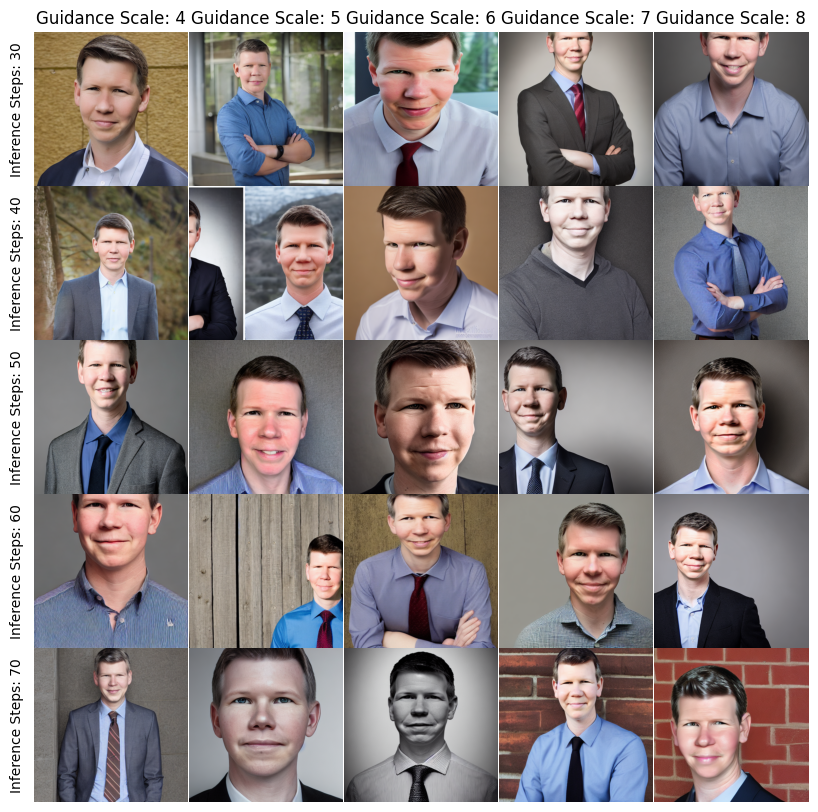

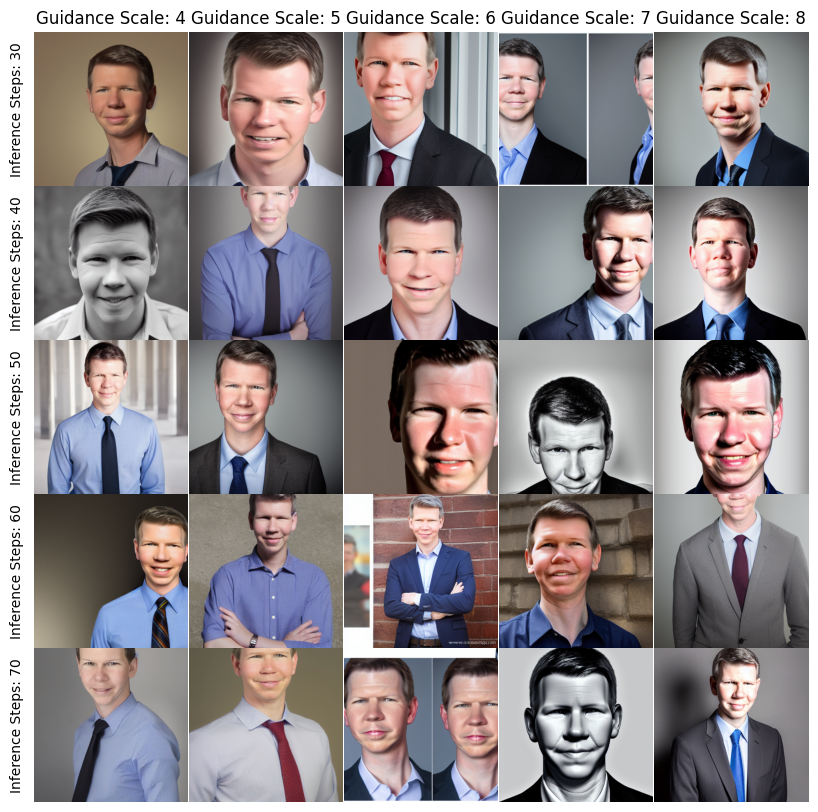

In [ ]:
plots = []
for output in pipe_outputs:
  fig, axs = create_image_grid(output, columns=grid_cols,rows=grid_rows, labels_x=labels_x, labels_y=labels_y)
  plt.subplots_adjust(hspace=0, wspace=0)
  plots.append(fig)
  plt.show()

## Save SD 1.5 Inference Grid Photos

In [ ]:
save_dir= "/content/drive/MyDrive/textinv/pat/output8"

### Single Image Download

In [ ]:
def save_image_set(image_set, save_dir, set_name):
  """Saves an image set to a specified directory.

  Args:
    image_set: A list of images to save.
    output_dir: The root directory where the set will be saved.
    set_name: The name of the subdirectory for the set.
  """

  # Create the subdirectory for the set
  set_dir = os.path.join(save_dir, set_name)
  os.makedirs(set_dir, exist_ok=True)

  # Save each image in the set
  for i, image in enumerate(image_set):
    image_path = os.path.join(set_dir, f'image_{i}.jpg')  # Adjust file format as needed
    image.save(image_path)

In [ ]:
for i, output in enumerate(pipe_outputs):
    save_image_set(output, save_dir, f"inference_grid_single_images_{i:03d}")

### Save and Download Inference Grid Image

In [ ]:
counter =0
for plot in plots:
  counter= counter+1
  filepath = os.path.join(save_dir, f"Inference_Grid_{counter}")
  plot.savefig(filepath)

## Inference (SDXL)

In [ ]:
pipeline = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True,
).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
# del pipeline
# torch.cuda.empty_cache()

In [ ]:
filepath= "/content/drive/MyDrive/results/archive/sdxl_leander_27/learned_embeds-steps-5000.safetensors"
embed_1=load_file(filepath)

filepath= "/content/drive/MyDrive/results/archive/sdxl_leander_27/learned_embeds_2-steps-5000.safetensors"
embed_2 = load_file(filepath)

# pipeline.load_textual_inversion(filepath, weight_name="model.safetensors", token="<sks>")
pipeline.load_textual_inversion(embed_1, text_encoder=pipeline.text_encoder, tokenizer=pipeline.tokenizer, token="<sks>")
pipeline.load_textual_inversion(embed_2, text_encoder=pipeline.text_encoder_2, tokenizer=pipeline.tokenizer_2, token="<sks>")

In [ ]:
# pipeline.load_textual_inversion("/content/drive/MyDrive/results/archive/sdxl_leander_27",token="<sks>")
# pipeline.load_textual_inversion("textinv/pat", weight_name="learned_embeds.safetensors",token="<sks>")

In [ ]:
from diffusers import DDIMScheduler, DDPMScheduler
pipeline.enable_attention_slicing()
pipeline.enable_vae_slicing()
pipeline.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)

In [ ]:
prompt = "business headshot of a <sks> man"
# neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

In [ ]:
def get_inputs(batch_size=1):
    # generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    # neg_prompts = batch_size * [neg_prompt]
    num_inference_steps = 30
    guidance_scale=8
    # embed= "learned_embeds.safetensors"
    # embed2= "learned_embeds_2.safetensors"
    # return {"prompt": prompts, "neg_prompt":neg_prompts, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}
    return {"prompt": prompts, "num_inference_steps": num_inference_steps, "guidance_scale": guidance_scale}

In [ ]:
prompt += "frontal shot, serious look, business clothing, handsome, beautiful face, model, photorealistic, masterpiece, ultra high res, ultra detailed, extremely detailed face"
prompt += "50mm portrait photography, 8k, high definition, plain white background"

In [ ]:
from diffusers.utils import make_image_grid
images = pipeline(**get_inputs(batch_size=4)).images



  0%|          | 0/30 [00:00<?, ?it/s]

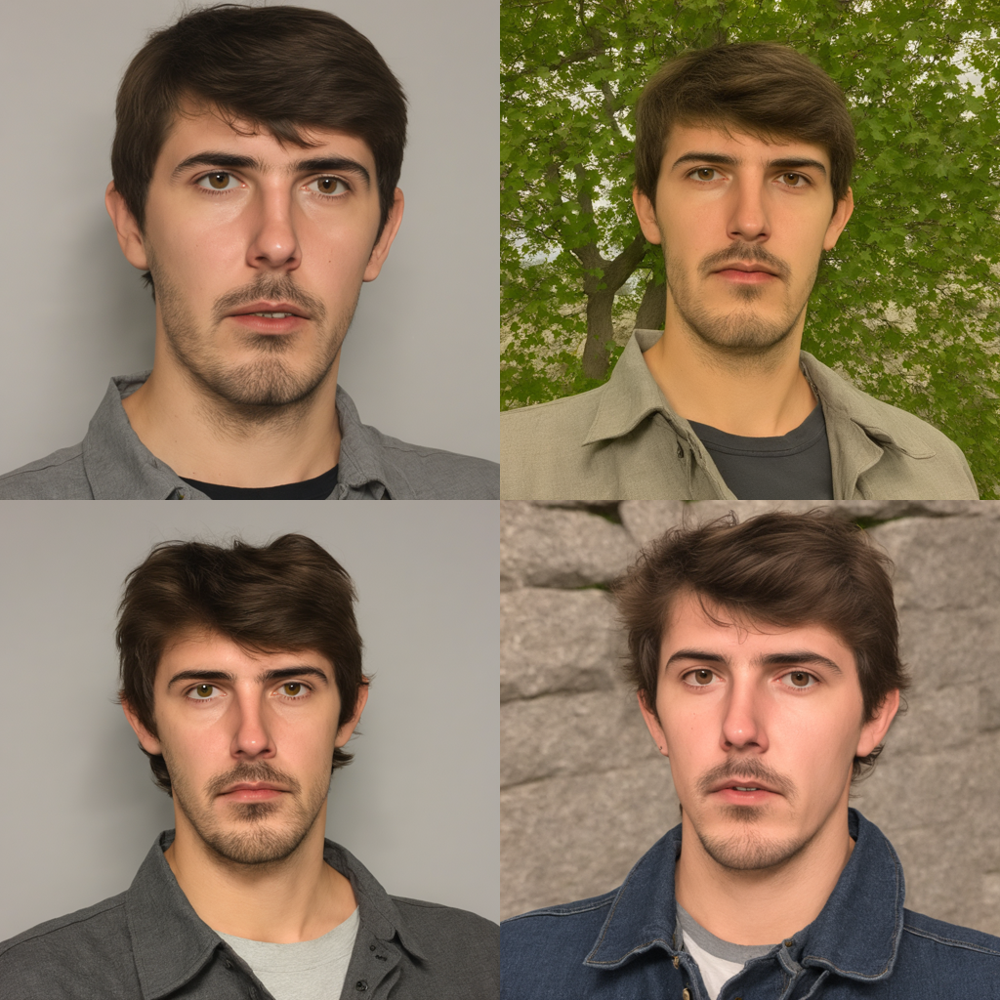

In [ ]:
make_image_grid(images, rows=2, cols=2, resize=512)

In [ ]:
for i, image in enumerate(images):
    image.save(f"image_{i}.png")

## Inference Grid (SDXL)

Thu Sep  5 13:27:38 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   73C    P0              34W /  72W |  14441MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
total_pipes = 2
pipes = []
schedulers = [DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler]

In [ ]:
filepath= "/content/drive/MyDrive/textinv/pat/sdxl_3/learned_embeds-steps-200.safetensors"
embed_1=load_file(filepath)

filepath= "/content/drive/MyDrive/textinv/pat/sdxl_3/learned_embeds_2-steps-200.safetensors"
embed_2 = load_file(filepath)

# file = hf_hub_download("dn118/unaestheticXL", filename="unaestheticXLv31.safetensors")
# state_dict = load_file(file)
# state_dict

In [ ]:
# del pipes
# torch.cuda.empty_cache()

In [ ]:
for i in range(total_pipes):
  pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True,
  ).to("cuda")

  pipe.load_textual_inversion(embed_1, text_encoder=pipe.text_encoder, tokenizer=pipe.tokenizer, token="<sks>")
  pipe.load_textual_inversion(embed_2, text_encoder=pipe.text_encoder_2, tokenizer=pipe.tokenizer_2, token="<sks>")

  # pipe.load_textual_inversion("/content/drive/MyDrive/textinv/pat/sdxl_3", weight_name="learned_embeds-steps-200.safetensors", token="<sks>")
  #   pipe.load_textual_inversion("/content/drive/MyDrive/textinv/pat/sdxl_3",weight_name="learned_embeds-steps-200.safetensors", token="<sks>")


  # pipe.load_textual_inversion("/content/drive/MyDrive/textinv/test/",token="<sks>")

  # pipe.load_textual_inversion(embed_1["clip_g"], token="ziprealism", text_encoder=pipe.text_encoder_2, tokenizer=pipe.tokenizer_2)
  # pipe.load_textual_inversion(embed_1["clip_l"], token="ziprealism", text_encoder=pipe.text_encoder, tokenizer=pipe.tokenizer)

  # pipe.load_textual_inversion(embed, token="<sks")
  # pipe.load_textual_inversion(embed_2, token="<sks>")
  pipe.enable_attention_slicing()
  pipe.scheduler = schedulers[i].from_config(pipe.scheduler.config)

  # if pipe.scheduler == DPMSolverMultistepScheduler:
  #   pipe.scheduler.use_karras_sigmas = True

  pipes.append(pipe)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
## free up GPU memory by pipes if necessary
# del pipes
# torch.cuda.empty_cache()

In [ ]:
# prompt = "(((business headshot of a handsome <sks> man))), professional clothing, serious face, open eyes"
prompt = "business headshot of a <sks> man, photorealistic, 8k UHD"
# prompt = "face portrait photo of george clooney, looking at viewer, in shirt, ziprealism"
# neg_prompt =""
neg_prompt = "(((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, old photo, low res, black and white, black and white filter, colorless, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquid tongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missing breasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fused ears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears, (((deformed))), blurry, bad anatomy, disfigured, poorly drawn face, mutation, mutated, (extra_limb), (ugly), (poorly drawn hands), fused fingers, messy drawing, broken legs censor, censored, censor_bar, multiple breasts, (mutated hands and fingers:1.5), (long body :1.3), (mutation, poorly drawn :1.2), black-white, bad anatomy, liquid body, liquidtongue, disfigured, malformed, mutated, anatomical nonsense, text font ui, error, malformed hands, long neck, blurred, lowers, low res, bad anatomy, bad proportions, bad shadow, uncoordinated body, unnatural body, fused breasts, bad breasts, huge breasts, poorly drawn breasts, extra breasts, liquid breasts, heavy breasts, missingbreasts, huge haunch, huge thighs, huge calf, bad hands, fused hand, missing hand, disappearing arms, disappearing thigh, disappearing calf, disappearing legs, fusedears, bad ears, poorly drawn ears, extra ears, liquid ears, heavy ears, missing ears,"

In [ ]:
# for pipe in pipes:
#   pipe.enable_vae_slicing()
#   pipe.enable_model_cpu_offload()
#   images = pipe(prompt=prompt, neg_prompt=neg_prompt, num_inference_steps=20, guidance_scale=10).images
  # helper = pipe(prompt=prompt+"ziprealism", neg_prompt=neg_prompt, num_inference_steps=20, guidance_scale=10).images


  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
inf_start= 40
scale_start=9
max_inf_steps=60
max_scale=11
inf_step_increase=10
scale_increase=1

In [ ]:
grid_rows=int(max_scale-scale_start)
grid_cols=int((max_inf_steps-inf_start)/inf_step_increase)

In [ ]:
print(grid_rows)
print(grid_cols)

2
2


In [ ]:
import itertools

def create_parameter_list(prompt, neg_prompt):
    """Creates a list of dictionaries containing the parameters.

    Args:
        prompt: The prompt for the model.
        neg_prompt: The negative prompt for the model.

    Returns:
        A list of dictionaries containing the parameters.
    """

    parameters = []
    for num_inference_steps in range(inf_start, max_inf_steps, inf_step_increase):
        for guidance_scale in range(scale_start, max_scale, scale_increase):
            parameters.append({
                "prompt": prompt,
                "neg_prompt": neg_prompt,
                "num_inference_steps": num_inference_steps,
                "guidance_scale": guidance_scale
            })
    return parameters

parameter_list = create_parameter_list(prompt, neg_prompt)

In [ ]:
def create_image_grid(images, columns, rows, figsize=(10,10),labels_x=None, labels_y=None):
    """
    Creates a grid of images using matplotlib and numpy.

    Args:
        images: A list of image data.
        columns: The number of columns in the grid.
        rows: The number of rows in the grid.
        labels_x: A list of labels for the x-axis (columns).
        labels_y: A list of labels for the y-axis (rows).

    Returns:
        The figure and axes objects.
    """

    fig, axs = plt.subplots(rows, columns, figsize=(10, 10))  # Adjust figure size as needed

    for i in range(rows):
        for j in range(columns):
            index = i * columns + j
            if index < len(images):
                axs[i, j].imshow(images[index])
                axs[i, j].tick_params(axis='both', length=0, width=0)
                axs[i, j].set_xticklabels([])
                axs[i, j].set_yticklabels([])
                axs[i, j].spines['top'].set_visible(False)
                axs[i, j].spines['right'].set_visible(False)
                axs[i, j].spines['bottom'].set_visible(False)
                axs[i, j].spines['left'].set_visible(False)

    # Add column labels
    if labels_x:
        for i in range(columns):
            axs[0, i].set_title(labels_x[i])

    # Add row labels
    if labels_y:
        for i in range(rows):
            axs[i, 0].set_ylabel(labels_y[i])

    return fig, axs

In [ ]:
inference_steps_list = my_list = list(OrderedDict.fromkeys([param["num_inference_steps"] for param in parameter_list]).keys())
guidance_scale_list = my_list = list(OrderedDict.fromkeys([param["guidance_scale"] for param in parameter_list]).keys())
labels_x = [f"Guidance Scale: {step}" for step in guidance_scale_list]
labels_y = [f"Inference Steps: {step}" for step in inference_steps_list]

In [ ]:
%%capture

pipe_outputs = []
for pipe in pipes:
    pipe.enable_vae_slicing()
    pipe.enable_model_cpu_offload()
    images = []
    for line in parameter_list:
        images.extend(pipe(prompt=prompt, neg_prompt=neg_prompt, num_inference_steps=line["num_inference_steps"], guidance_scale=line["guidance_scale"]).images)
    pipe_outputs.append(images)

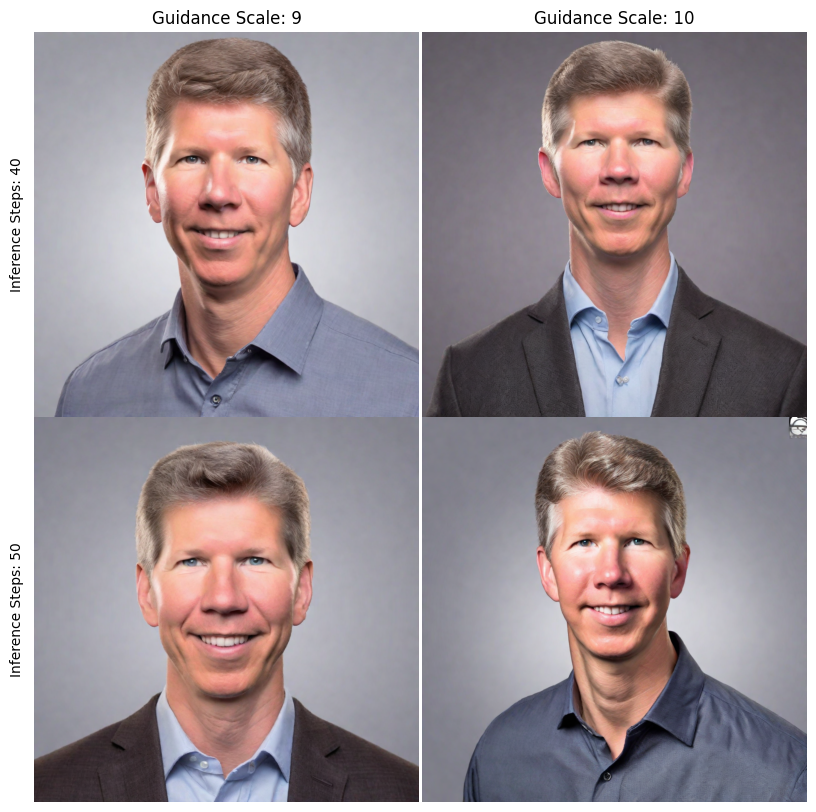

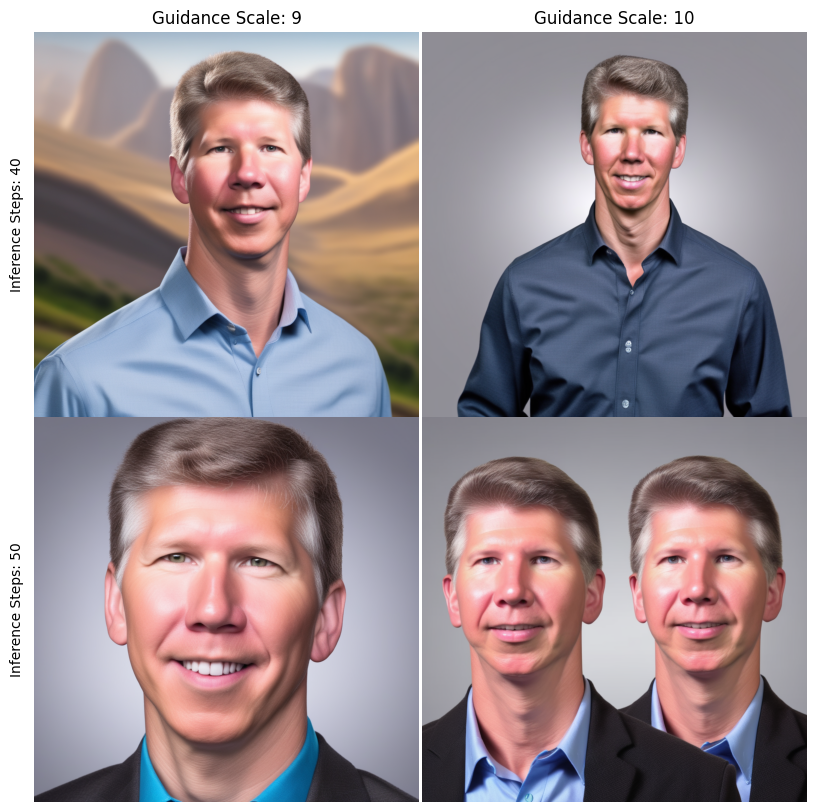

In [ ]:
plots = []
for output in pipe_outputs:
  fig, axs = create_image_grid(output, columns=grid_cols,rows=grid_rows, labels_x=labels_x, labels_y=labels_y)
  plt.subplots_adjust(hspace=0, wspace=0)
  plots.append(fig)
  plt.show()

## Save SD XL Inference Grid Photos

In [ ]:
save_dir= "/content/drive/MyDrive/textinv/pat/sdxl_3/output"

### Single Image Download

In [ ]:
import os
from google.colab import drive

def save_image_set(image_set, save_dir, set_name):
  """Saves an image set to a specified directory.

  Args:
    image_set: A list of images to save.
    output_dir: The root directory where the set will be saved.
    set_name: The name of the subdirectory for the set.
  """

  # Create the subdirectory for the set
  set_dir = os.path.join(save_dir, set_name)
  os.makedirs(set_dir, exist_ok=True)

  # Save each image in the set
  for i, image in enumerate(image_set):
    image_path = os.path.join(set_dir, f'image_{i}.jpg')  # Adjust file format as needed
    image.save(image_path)

In [ ]:
for i, output in enumerate(pipe_outputs):
    save_image_set(output, save_dir, f"inference_grid_single_images_{i:03d}")

### Save and Download Inference Grid Image

In [ ]:
counter =0
for plot in plots:
  counter= counter+1
  filepath = os.path.join(save_dir, f"Inference_Grid_{counter}")
  plot.savefig(filepath)

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/textinv/pat/sdxl_3/output/Inference_Grid_1.png'

# Download Embed

In [ ]:

shutil.make_archive('dil_embed2', 'zip', base_dir='textinv/dil_test2')
files.download("dil_embed2.zip")

# !unzip textinv/dil_embed.zip

# test

In [ ]:
generator = torch.Generator("cuda").manual_seed(0)

In [ ]:
pipeline2 = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, safety_checker= None, use_safetensors=True
).to("cuda")

pipeline.load_textual_inversion("textinv/dil_test2", safety_checker=None, token="<sks>")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
prompt = "a business headshot of a <sks> woman"

  0%|          | 0/50 [00:00<?, ?it/s]

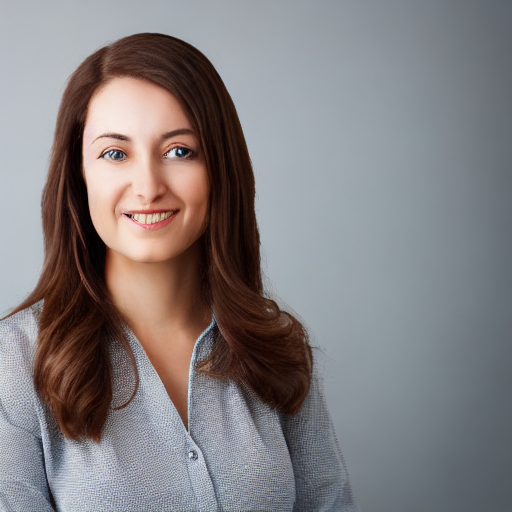

In [ ]:
image = pipeline2(prompt, generator=generator).images[0]
image

In [ ]:
pipeline2.scheduler.compatibles

[diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_edm_euler.EDMEulerScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler

In [ ]:
from diffusers import DDIMScheduler

pipeline2.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)

  0%|          | 0/20 [00:00<?, ?it/s]

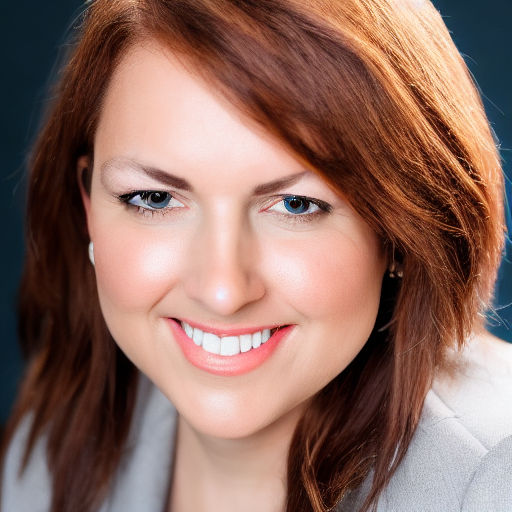

In [ ]:
generator = torch.Generator("cuda").manual_seed(0)
image = pipeline2(prompt, generator=generator, num_inference_steps=20, guidance_scale=7.5).images[0]
image

In [ ]:
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 20

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}

  0%|          | 0/20 [00:00<?, ?it/s]

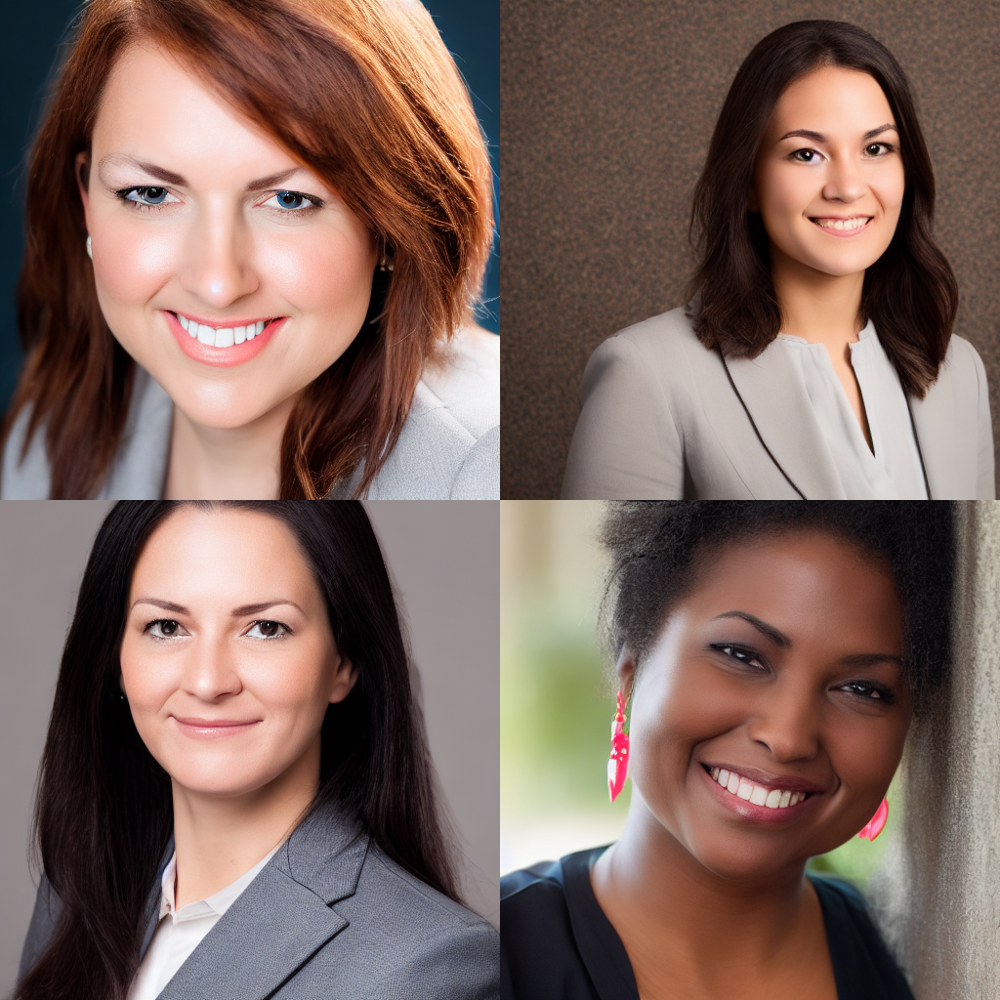

In [ ]:
from diffusers.utils import make_image_grid

images = pipeline2(**get_inputs(batch_size=4)).images
make_image_grid(images, 2, 2)

  0%|          | 0/20 [00:00<?, ?it/s]

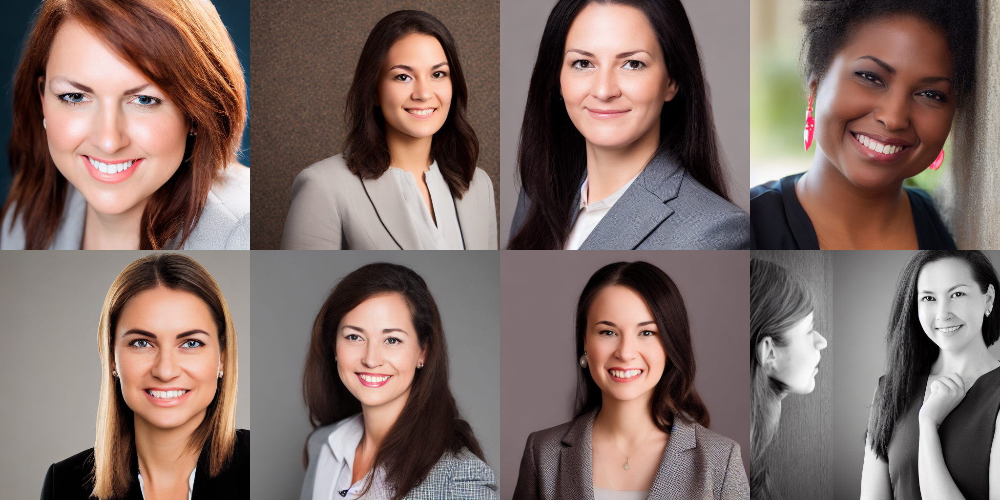

In [ ]:
images = pipeline2(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

In [ ]:
pipeline2.enable_attention_slicing()

  0%|          | 0/20 [00:00<?, ?it/s]

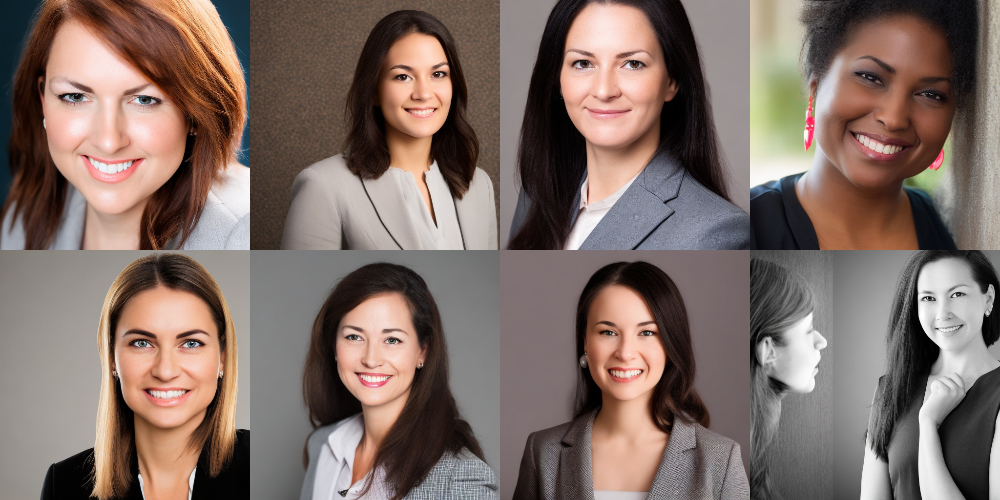

In [ ]:
from diffusers import AutoencoderKL

vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
pipeline2.vae = vae
images = pipeline2(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

In [ ]:
prompt += "side profile, looking away, serious eye, business attire"
prompt += " 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta"

  0%|          | 0/20 [00:00<?, ?it/s]

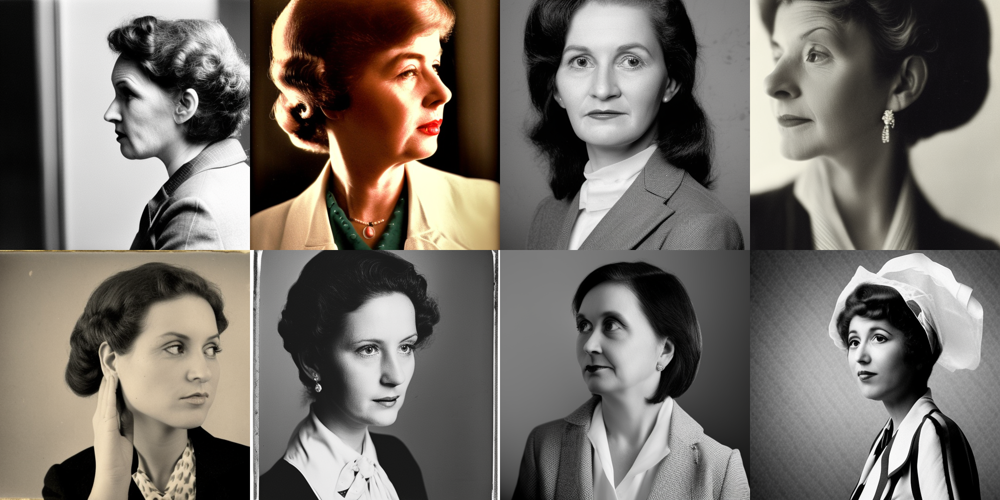

In [ ]:
images = pipeline2(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

In [ ]:
prompt = "a vintage photograph of a woman in the 70s"

num_samples_per_row = 2
num_rows = 2

In [ ]:
all_images = []

for _ in range(num_rows):
    # images = pipeline(prompt, num_images_per_prompt=num_samples_per_row, num_inference_steps=200, guidance_scale=7.5).images
    images = pipeline2(prompt, num_images_per_prompt=num_samples_per_row).images
    # images = pipeline_text2image(prompt=prompt, num_images_per_prompt=num_samples_per_row, num_inference_steps=100, guidance_scale=15).images
    all_images.extend(images)


# Save all images individually
for i, image in enumerate(all_images):
    image.save(f"image_{i}.png")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

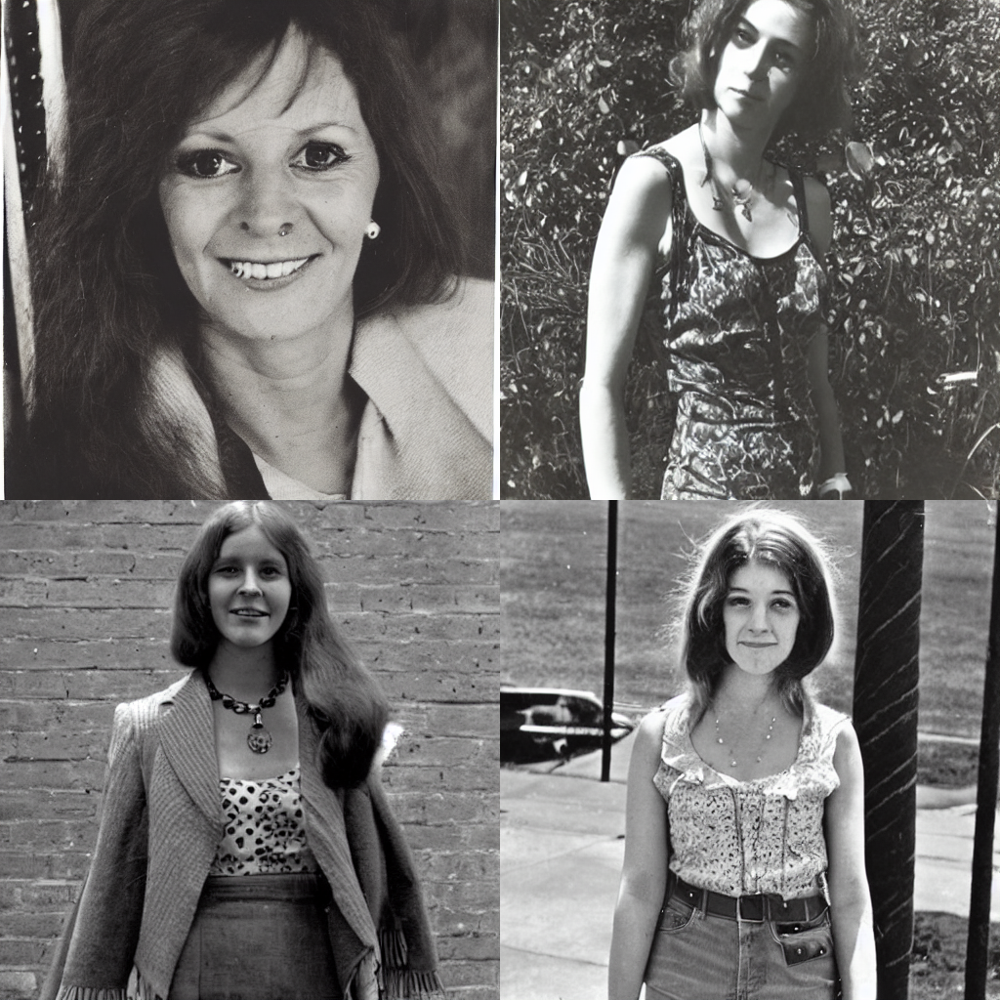

In [ ]:
grid = make_image_grid(all_images, num_rows, num_samples_per_row)
grid